In [2]:
import altair as alt
import polars as pl
import polars.selectors as cs

# Needed for larger datasets
alt.data_transformers.enable("vegafusion")

# alt.renderers.enable("browser")

DataTransformerRegistry.enable('vegafusion')

In [3]:
X = pl.read_csv("X_train.csv")
y = pl.read_csv("Y_train.csv")
X = X.with_columns(pl.col("Time").str.to_datetime("%d/%m/%Y %H:%M"))
X_y = X.join(y, on="ID")
# For now, let us focus on just one of the 6 wind farms so that we understand the structure of the data.

In [ ]:
X_WF1 = X.filter(pl.col("WF") == "WF1")
X_y_WF1 = X_y.filter(pl.col("WF") == "WF1")
X_WF1.filter(pl.col("Time").dt.hour() == 0)
X_WF1["Time"].max()
# Let's look at column `NWP1_00h_D-2_U`.
#
# According to the docs, this is what this column name means:
# "The zonal component of wind speed, $U$, right now, as predicted two days ago (`D-2`), at midnight (`00h`), by weather station no. 1 (`NWP1`)"

In [ ]:
alt.Chart(X_WF1).mark_line().encode(
    x="Time:T", y="NWP1_00h_D-2_U:Q", tooltip=alt.Tooltip("Time:T", format="%H:%M")
).interactive()
# The weather prediction columns have many null values. Is there a pattern in those?

In [ ]:
(
    list(
        X_WF1.filter(pl.col("NWP1_00h_D-2_U").is_not_null())["Time"].dt.hour().unique()
    ),
    list(
        X_WF1.filter(pl.col("NWP1_06h_D-2_U").is_not_null())["Time"].dt.hour().unique()
    ),
    list(
        X_WF1.filter(pl.col("NWP1_12h_D-2_U").is_not_null())["Time"].dt.hour().unique()
    ),
    list(
        X_WF1.filter(pl.col("NWP1_18h_D-2_U").is_not_null())["Time"].dt.hour().unique()
    ),
)
# We have some complementary data about the wind farms. Let's take a short look.

In [9]:
X_comp = pl.read_csv("WindFarms_complementary_data.csv", separator=";")
X_comp = X_comp.filter(pl.col("Time (UTC)").is_not_null())
X_comp = X_comp.with_columns(pl.col("Time (UTC)").str.to_datetime("%d/%m/%Y %H:%M"))

(
    alt.Chart(
        X_comp.filter(
            (pl.col("Wind Farm") == "WF1") & (pl.col("Wind Turbine") == "TE1")
        ).with_columns(
            (pl.col("Wind direction (�)") - pl.col("Nacelle direction (�)")).alias(
                "Nacelle misalignment (deg)"
            )
        )
    )
    .mark_point()
    .encode(x="Time (UTC)", y="Nacelle misalignment (deg)")
)

alt.Chart(...)

Now let us look at the target column specifically.

In [10]:
# Statistics of power production
X_y_WF1["Production"].describe()

statistic,value
str,f64
"""count""",6239.0
"""null_count""",0.0
"""mean""",2.33068
"""std""",2.972659
"""min""",0.0
"""25%""",0.01
"""50%""",0.82
"""75%""",3.9
"""max""",10.14


In [13]:
# Histogram
(
    alt.Chart(X_y_WF1)
    .mark_bar()
    .encode(
        alt.X("Production", bin=alt.Bin(step=0.5)).title("Production (MWh)"),
        y=alt.Y("count()").title("Frequency"),
    )
    .properties(width=800)
)

# The distribution of production is heavily right skewed. The median is 0.82 MW.
# According to Our World in Data 2017 (https://ourworldindata.org/scale-for-electricity), a French person consumes 0.019 MWh/day

alt.Chart(...)

In [14]:
# Total production for the month
(
    alt.Chart(X_y_WF1)
    .mark_line()
    .encode(
        x="yearmonth(Time):T",
        y=alt.Y("sum(Production)").title("Total production (MWh)"),
    )
    .properties(width=800)
)

alt.Chart(...)

There's a big drop in December 2018, compared to November and January. Is it because demand dropped, or because the data was corrupted, or because the wind farms were in maintenance?


In [17]:
(
    alt.Chart(
        X_y_WF1.filter(pl.col("Time").dt.month() == 12),
        title="Hourly production in December 2018",
    )
    .mark_line()
    .encode(x="Time", y="Production")
    .properties(width=1000)
)

alt.Chart(...)

It turns out the power production was very near zero for 9 consecutive days, from 12 December to 21 December.


Now let us try training a model using the classic `sktime` workflow, to get become familiar with it.

In [5]:
import numpy as np
from sktime.forecasting.compose import make_reduction
from sklearn.ensemble import RandomForestRegressor
from sktime.performance_metrics.forecasting import MeanAbsolutePercentageError
from sktime.split import temporal_train_test_split

# Format the data to be sktime-friendly
y_train, y_test, X_train, X_test = temporal_train_test_split(
    y=X_y_WF1["Production"].to_pandas(), X=X_WF1.drop(["ID", "WF", "Time"]).to_pandas()
)

fh = np.arange(1, len(y_test) + 1)  # forecasting horizon
regressor = RandomForestRegressor()
forecaster = make_reduction(
    regressor,
    strategy="recursive",
    window_length=12,
)

In [10]:
# Takes a while
forecaster.fit(y=y_train, X=X_train, fh=fh)

RecursiveTabularRegressionForecaster(estimator=RandomForestRegressor(),
                                     window_length=12)

In [11]:
y_pred = forecaster.predict(fh=fh, X=X_test)
smape = MeanAbsolutePercentageError()
smape(y_test, y_pred)

np.float64(5542800044925143.0)

In [18]:
# Show predictions with test
df = (
    pl.DataFrame({"y_pred": y_pred, "y_test": y_test})
    .with_row_index()
    .unpivot(index="index")
)
alt.Chart(
    df, title="Comparison of predicted and true production on the test set"
).mark_line().encode(
    x="index", y=alt.X("value").title("Production (MWh)"), color="variable"
)
# It's not great

alt.Chart(...)

Let us explore the data some more to find patterns in the target.

In [ ]:
# Average production depending on the day of the week
(
    alt.Chart(X_y_WF1.with_columns(pl.col("Time").dt.weekday().alias("Day of week")))
    .mark_bar()
    .encode(x="Day of week", y="mean(Production)")
    + alt.Chart(X_y_WF1.with_columns(pl.col("Time").dt.weekday().alias("Day of week")))
    .mark_errorbar(extent="iqr")
    .encode(x="Day of week", y="Production")
)
# 1 is Monday, 7 is Sunday
# Top production is on Mondays and Sundays, bottom is Thursdays

# Error bars are the IQR

alt.LayerChart(...)

In [ ]:
# Average production depending on month of the year
base = alt.Chart(X_y_WF1.with_columns(pl.col("Time").dt.month().alias("Month")))
(
    base.mark_bar().encode(x="Month", y="mean(Production)")
    + base.mark_errorbar(extent="iqr").encode(x="Month", y="Production")
)

# 1 is January, 12 is December
# Top production is January by far, bottom is August/September
# December is low, as mentioned earlier

# The error bars show the inter-quartile range (bottom is 25% quantile, top is 75% quantile)
# This way we can clearly see that a lot of the data is very close to 0

alt.LayerChart(...)

Let us see if the different predictions of the same meteorological variable ($U$) are coherent with each other. If so, we should remove some of them or combine them.

In [19]:
import polars.selectors as cs

In [27]:
nwp1 = X_y_WF1.select(cs.matches("Time") | (cs.matches("NWP1") & cs.matches("_U")))
alt.Chart(
    nwp1.unpivot(index="Time"), title="Predicted value of U from different forecasts"
).mark_point().encode(
    x="Time",
    y=alt.Y("value").title("Predicted value of U (m/s)"),
    color=alt.Color(
        "variable", legend=alt.Legend(orient="left", title="Prediction time")
    ),
).properties(width=5000, height=500)
X_y_WF1.with_columns(
    mean_U=pl.mean_horizontal((cs.matches("NWP1") & cs.matches("_U"))),
    min_U=pl.min_horizontal((cs.matches("NWP1") & cs.matches("_U"))),
    max_U=pl.max_horizontal((cs.matches("NWP1") & cs.matches("_U"))),
)

alt.Chart(...)

In [ ]:
(
    alt.Chart(nwp1.melt(id_vars="Time")).mark_line().encode(x="Time", y="mean(value)")
    + alt.Chart(nwp1.melt(id_vars="Time"))
    .mark_errorband(extent="ci")
    .encode(x="Time", y="value")
).properties(width=5000, height=500)

alt.LayerChart(...)

Let us further study patterns in the target variable, to see if it could be sufficient to build a model just based on past values (and not any of the other variables).

In [ ]:
# Auto-correlation of y

from sktime.transformations.series.acf import AutoCorrelationTransformer

transformer = AutoCorrelationTransformer()
y_hat = transformer.fit_transform(X_y_WF1["Production"].to_pandas())

In [30]:
alt.Chart(pl.DataFrame(dict(y_hat=y_hat)).with_row_index()).mark_point().encode(
    x="index", y="y_hat"
)

alt.Chart(...)

In [ ]:
from statsmodels.graphics.tsaplots import plot_pacf

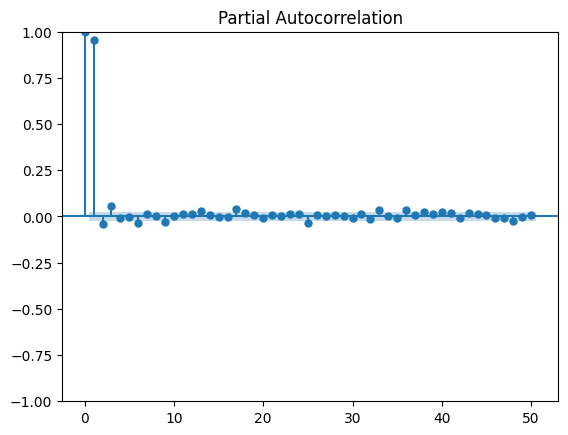

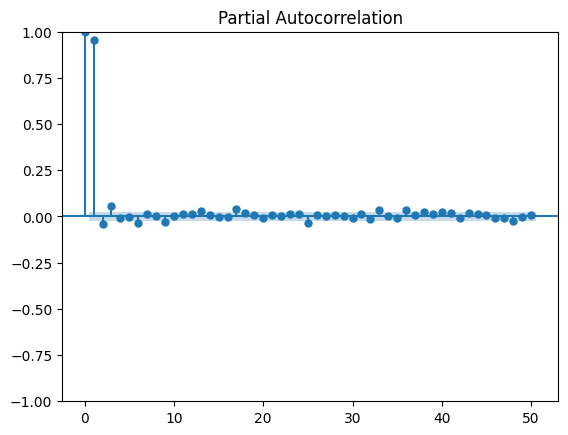

In [29]:
plot_pacf(X_y_WF1["Production"], lags=50)

Let's try to build another forecaster based on a different sklearn regressor.

In [31]:
from sklearn.ensemble import HistGradientBoostingRegressor
from sktime.split import temporal_train_test_split
import numpy as np
from sktime.forecasting.compose import make_reduction

y_train, y_test, X_train, X_test = temporal_train_test_split(
    y=X_y_WF1["Production"].to_pandas(), X=X_WF1.drop(["ID", "WF", "Time"]).to_pandas()
)

fh = np.arange(1, len(y_test) + 1)  # forecasting horizon
regressor = HistGradientBoostingRegressor()
forecaster = make_reduction(
    regressor,
    strategy="recursive",
    window_length=24,
)

In [32]:
forecaster.fit(fh=fh, y=y_train)

RecursiveTabularRegressionForecaster(estimator=HistGradientBoostingRegressor(),
                                     window_length=24)

In [37]:
y_pred = forecaster.predict(fh=fh)
y_pred

4679    9.920290
4680    9.524700
4681    9.568384
4682    9.591434
4683    9.536123
          ...   
6234    3.497278
6235    3.497278
6236    3.497278
6237    3.497278
6238    3.497278
Name: Production, Length: 1560, dtype: float64

In [40]:
df = pl.DataFrame({"y_pred": y_pred, "y_test": y_test}).with_row_index().melt("index")
alt.Chart(
    df, title="Comparison of predicted and true production on the test set"
).mark_line().encode(
    x="index", y=alt.X("value").title("Production (MWh)"), color="variable"
)
# Terrible

alt.Chart(...)

Let us look at the correlations between each exogenous variable and the energy production.

In [44]:
alt.Chart(X_y_WF1).mark_point().encode(
    x=alt.X(alt.repeat("column"), type="quantitative"), y="Production"
).repeat(column=X_y_WF1.columns[3:-1])

alt.RepeatChart(...)

According to the docs it might be useful to compute the actual wind speed from the $U$ and $V$ components. Let's take a look!

In [47]:
import itertools

In [62]:
speed_columns = [
    (
        pl.col(f"{station}_{hour}_{day}_U") ** 2
        + pl.col(f"{station}_{hour}_{day}_V") ** 2
    )
    .sqrt()
    .alias(f"{station}_{hour}_{day}_Speed")
    for station, hour, day in itertools.product(
        ["NWP1", "NWP2", "NWP3", "NWP4"],
        ["00h", "06h", "12h", "18h"],
        ["D-2", "D-1", "D"],
    )
    if f"{station}_{hour}_{day}_U" in X_y_WF1.columns
]

X_y_WF1.with_columns(speed_columns)

ID,WF,Time,NWP1_00h_D-2_U,NWP1_00h_D-2_V,NWP1_00h_D-2_T,NWP1_06h_D-2_U,NWP1_06h_D-2_V,NWP1_06h_D-2_T,NWP1_12h_D-2_U,NWP1_12h_D-2_V,NWP1_12h_D-2_T,NWP1_18h_D-2_U,NWP1_18h_D-2_V,NWP1_18h_D-2_T,NWP1_00h_D-1_U,NWP1_00h_D-1_V,NWP1_00h_D-1_T,NWP1_06h_D-1_U,NWP1_06h_D-1_V,NWP1_06h_D-1_T,NWP1_12h_D-1_U,NWP1_12h_D-1_V,NWP1_12h_D-1_T,NWP1_18h_D-1_U,NWP1_18h_D-1_V,NWP1_18h_D-1_T,NWP1_00h_D_U,NWP1_00h_D_V,NWP1_00h_D_T,NWP1_06h_D_U,NWP1_06h_D_V,NWP1_06h_D_T,NWP1_12h_D_U,NWP1_12h_D_V,NWP1_12h_D_T,NWP1_18h_D_U,…,Production,NWP1_00h_D-2_Speed,NWP1_00h_D-1_Speed,NWP1_00h_D_Speed,NWP1_06h_D-2_Speed,NWP1_06h_D-1_Speed,NWP1_06h_D_Speed,NWP1_12h_D-2_Speed,NWP1_12h_D-1_Speed,NWP1_12h_D_Speed,NWP1_18h_D-2_Speed,NWP1_18h_D-1_Speed,NWP1_18h_D_Speed,NWP2_00h_D-2_Speed,NWP2_00h_D-1_Speed,NWP2_00h_D_Speed,NWP2_12h_D-2_Speed,NWP2_12h_D-1_Speed,NWP2_12h_D_Speed,NWP3_00h_D-2_Speed,NWP3_00h_D-1_Speed,NWP3_00h_D_Speed,NWP3_06h_D-2_Speed,NWP3_06h_D-1_Speed,NWP3_06h_D_Speed,NWP3_12h_D-2_Speed,NWP3_12h_D-1_Speed,NWP3_12h_D_Speed,NWP3_18h_D-2_Speed,NWP3_18h_D-1_Speed,NWP3_18h_D_Speed,NWP4_00h_D-2_Speed,NWP4_00h_D-1_Speed,NWP4_00h_D_Speed,NWP4_12h_D-2_Speed,NWP4_12h_D-1_Speed,NWP4_12h_D_Speed
i64,str,datetime[μs],f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,…,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
1,"""WF1""",2018-05-01 01:00:00,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,-2.2485,-3.2578,286.44,null,null,null,null,null,null,null,…,0.02,null,null,3.95841,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1.287613,null,null,null
2,"""WF1""",2018-05-01 02:00:00,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,-2.4345,-1.4461,286.26,null,null,null,null,null,null,null,…,0.07,null,null,2.831607,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2.524975,null,null,null
3,"""WF1""",2018-05-01 03:00:00,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,3.3659,-3.0605,285.75,null,null,null,null,null,null,null,…,0.22,null,null,4.549279,null,null,null,null,null,null,null,null,null,null,null,3.50845,null,null,null,3.729333,6.215494,2.54845,1.713244,6.226493,null,4.795772,3.891066,null,1.916922,2.246821,null,null,null,1.73113,null,null,null
4,"""WF1""",2018-05-01 04:00:00,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,3.7065,-6.2174,284.78,null,null,null,null,null,null,null,…,0.39,null,null,7.238384,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1.18318,null,null,null
5,"""WF1""",2018-05-01 05:00:00,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,3.8134,-5.4446,284.46,null,null,null,null,null,null,null,…,0.41,null,null,6.647232,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,0.414344,null,null,null
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
6235,"""WF1""",2019-01-15 20:00:00,null,null,null,null,null,null,0.3473,-8.5346,280.01,-1.5473,-7.3751,279.83,-1.8275,-7.4787,279.64,-1.4071,-7.5982,279.89,-2.5989,-7.1385,280.03,-3.1709,-5.6166,280.6,-1.8757,-7.1469,280.52,-2.578,-7.1942,280.53,-3.1851,-6.6765,280.46,-2.5467,…,0.45,null,7.698747,7.38894,null,7

In [65]:
with pl.Config(tbl_rows=-1):
    print(
        X_y_WF1.with_columns(speed_columns)
        .select(
            [
                pl.corr("Production", a).alias(f"corr_{a}")
                for a in X_y_WF1.with_columns(speed_columns).columns
            ]
        )
        .transpose(include_header=True)
    )

shape: (142, 2)
┌─────────────────────────┬───────────┐
│ column                  ┆ column_0  │
│ ---                     ┆ ---       │
│ str                     ┆ f64       │
╞═════════════════════════╪═══════════╡
│ corr_ID                 ┆ 0.278216  │
│ corr_WF                 ┆ NaN       │
│ corr_Time               ┆ 0.278232  │
│ corr_NWP1_00h_D-2_U     ┆ 0.208312  │
│ corr_NWP1_00h_D-2_V     ┆ -0.412445 │
│ corr_NWP1_00h_D-2_T     ┆ -0.226055 │
│ corr_NWP1_06h_D-2_U     ┆ 0.135953  │
│ corr_NWP1_06h_D-2_V     ┆ -0.410068 │
│ corr_NWP1_06h_D-2_T     ┆ -0.220344 │
│ corr_NWP1_12h_D-2_U     ┆ 0.093855  │
│ corr_NWP1_12h_D-2_V     ┆ -0.402009 │
│ corr_NWP1_12h_D-2_T     ┆ -0.237037 │
│ corr_NWP1_18h_D-2_U     ┆ 0.12391   │
│ corr_NWP1_18h_D-2_V     ┆ -0.425595 │
│ corr_NWP1_18h_D-2_T     ┆ -0.241715 │
│ corr_NWP1_00h_D-1_U     ┆ 0.138326  │
│ corr_NWP1_00h_D-1_V     ┆ -0.415855 │
│ corr_NWP1_00h_D-1_T     ┆ -0.237464 │
│ corr_NWP1_06h_D-1_U     ┆ 0.147345  │
│ corr_NWP1_06h_D-1_V   

In [67]:
alt.Chart(X_y_WF1.with_columns(speed_columns)).mark_point().encode(
    x=alt.X(alt.repeat("column"), type="quantitative"), y="Production"
).repeat(
    column=[
        col for col in X_y_WF1.with_columns(speed_columns).columns if "Speed" in col
    ]
)

alt.RepeatChart(...)

"Total" Wind speed is indeed highly correlated with electricity production. One question these plots prompt is:
How often do we see high wind speeds, yet production at or near 0?

In [72]:
with pl.Config(tbl_rows=-1):
    print(
        X_y_WF1.with_columns(speed_columns)
        .select(
            [
                pl.corr("Production", a).alias(f"corr_{a}")
                for a in X_y_WF1.with_columns(speed_columns).columns
                if "Speed" in a
            ]
        )
        .transpose(include_header=True)
    )

shape: (36, 2)
┌─────────────────────────┬──────────┐
│ column                  ┆ column_0 │
│ ---                     ┆ ---      │
│ str                     ┆ f64      │
╞═════════════════════════╪══════════╡
│ corr_NWP1_00h_D-2_Speed ┆ 0.762631 │
│ corr_NWP1_00h_D-1_Speed ┆ 0.781304 │
│ corr_NWP1_00h_D_Speed   ┆ 0.813415 │
│ corr_NWP1_06h_D-2_Speed ┆ 0.762348 │
│ corr_NWP1_06h_D-1_Speed ┆ 0.784854 │
│ corr_NWP1_06h_D_Speed   ┆ 0.813388 │
│ corr_NWP1_12h_D-2_Speed ┆ 0.761368 │
│ corr_NWP1_12h_D-1_Speed ┆ 0.798697 │
│ corr_NWP1_12h_D_Speed   ┆ 0.812878 │
│ corr_NWP1_18h_D-2_Speed ┆ 0.787435 │
│ corr_NWP1_18h_D-1_Speed ┆ 0.810897 │
│ corr_NWP1_18h_D_Speed   ┆ 0.843342 │
│ corr_NWP2_00h_D-2_Speed ┆ 0.778721 │
│ corr_NWP2_00h_D-1_Speed ┆ 0.802875 │
│ corr_NWP2_00h_D_Speed   ┆ 0.812912 │
│ corr_NWP2_12h_D-2_Speed ┆ 0.786204 │
│ corr_NWP2_12h_D-1_Speed ┆ 0.806778 │
│ corr_NWP2_12h_D_Speed   ┆ 0.82736  │
│ corr_NWP3_00h_D-2_Speed ┆ 0.729729 │
│ corr_NWP3_00h_D-1_Speed ┆ 0.756777 │
│ corr_NWP

In [74]:
with pl.Config(tbl_rows=-1):
    print(
        X_y_WF1.with_columns(speed_columns)
        .filter(pl.col("Production") > 0.05)
        .select(
            [
                pl.corr("Production", a).alias(f"corr_{a}")
                for a in X_y_WF1.with_columns(speed_columns).columns
                if "Speed" in a
            ]
        )
        .transpose(include_header=True)
    )

shape: (36, 2)
┌─────────────────────────┬──────────┐
│ column                  ┆ column_0 │
│ ---                     ┆ ---      │
│ str                     ┆ f64      │
╞═════════════════════════╪══════════╡
│ corr_NWP1_00h_D-2_Speed ┆ 0.715867 │
│ corr_NWP1_00h_D-1_Speed ┆ 0.759201 │
│ corr_NWP1_00h_D_Speed   ┆ 0.800844 │
│ corr_NWP1_06h_D-2_Speed ┆ 0.735024 │
│ corr_NWP1_06h_D-1_Speed ┆ 0.764848 │
│ corr_NWP1_06h_D_Speed   ┆ 0.809232 │
│ corr_NWP1_12h_D-2_Speed ┆ 0.732216 │
│ corr_NWP1_12h_D-1_Speed ┆ 0.780196 │
│ corr_NWP1_12h_D_Speed   ┆ 0.811317 │
│ corr_NWP1_18h_D-2_Speed ┆ 0.767915 │
│ corr_NWP1_18h_D-1_Speed ┆ 0.793165 │
│ corr_NWP1_18h_D_Speed   ┆ 0.827144 │
│ corr_NWP2_00h_D-2_Speed ┆ 0.741974 │
│ corr_NWP2_00h_D-1_Speed ┆ 0.787111 │
│ corr_NWP2_00h_D_Speed   ┆ 0.800641 │
│ corr_NWP2_12h_D-2_Speed ┆ 0.765105 │
│ corr_NWP2_12h_D-1_Speed ┆ 0.79154  │
│ corr_NWP2_12h_D_Speed   ┆ 0.834582 │
│ corr_NWP3_00h_D-2_Speed ┆ 0.671172 │
│ corr_NWP3_00h_D-1_Speed ┆ 0.722708 │
│ corr_NWP

When you remove rows with small elecricity production, the correlation between speed and production decreases!
This might indicate that there are many occurrences with very low wind speeds and very low production.

I'm curious: When the production is very low, how often is it that the wind speed is low?

In [81]:
(
    alt.Chart(X_y_WF1.with_columns(speed_columns).filter(pl.col("Production") < 0.05))
    .mark_bar()
    .encode(
        x=alt.X("NWP1_00h_D-2_Speed", bin=True, title="NWP1_00h_D-2_Speed (m/s)"),
        y=alt.Y("count()", title="Frequency"),
    )
)

alt.Chart(...)

At a glance it looks abnormal -- we'd expect very low speeds to be more frequent. However, we need to get an idea of scales here: according to the [Beaufort wind force scale](https://en.wikipedia.org/wiki/Beaufort_scale), 5 m/s corresponds to a "Gentle Breeze". Thinking about it more closely, it makes sense that, at 100m altitude, the wind always blows at least a little.

Let us try yet another sklearn regressor.

In [87]:
fh = np.arange(1, len(y_test) + 1)  # forecasting horizon
regressor = RandomForestRegressor()
forecaster = make_reduction(
    regressor,
    strategy="recursive",
    window_length=12,
)

forecaster.fit(y_train)

RecursiveTabularRegressionForecaster(estimator=RandomForestRegressor(),
                                     window_length=12)

In [93]:
df = (
    pl.DataFrame({"y_pred": forecaster.predict(fh), "y_test": y_test})
    .with_row_index()
    .melt("index")
)
(
    alt.Chart(df).mark_line().encode(x="index", y="value", color="variable")
    + alt.Chart().mark_rule().encode(y=alt.datum(y_test.mean()))
)

alt.LayerChart(...)

It appears the model is predicting a constant close to the mean of `y_test`.